In [1]:
# import dependencies
import pandas as pd
import sqlite3
from datetime import datetime, timedelta
from fbprophet import Prophet

from fbprophet.plot import plot_plotly
import plotly.offline as py

import plotly.offline as py
import plotly.graph_objs as go

ModuleNotFoundError: No module named 'fbprophet'

In [ ]:
# Create your connections with indoor and outdoor databases
Ocnx = sqlite3.connect('Outdoor.db')
Icnx = sqlite3.connect('Indoor.db')
Outdoor_df = pd.read_sql_query("SELECT * FROM BME_DATA", Ocnx)
Indoor_df = pd.read_sql_query("SELECT * FROM BME_DATA", Icnx)

In [2]:
# Convert time into datetime
Outdoor_df['TIME_STAMP'] = pd.to_datetime(Outdoor_df['TIME_STAMP'])
Indoor_df['TIME_STAMP'] = pd.to_datetime(Indoor_df['TIME_STAMP'])

NameError: name 'Outdoor_df' is not defined

In [6]:
Outdoor_df['TIME_STAMP'] = Outdoor_df['TIME_STAMP'].dt.round('1min')
Indoor_df['TIME_STAMP'] = Indoor_df['TIME_STAMP'].dt.round('1min')

In [7]:
# Deleting the wrong input at the first rows
Outdoor_df = Outdoor_df.iloc[1:]
Indoor_df = Indoor_df.iloc[1:]

In [8]:
# converting temperature from C to f
Outdoor_df['TEMPERATURE'] = round((Outdoor_df['TEMPERATURE']* 9/5) + 32)
Indoor_df['TEMPERATURE'] = round((Indoor_df['TEMPERATURE']* 9/5) + 32)

In [9]:
# Merging Indor and Outdoor (on time stamp)
master_df = pd.merge(Outdoor_df, Indoor_df, on = "TIME_STAMP", how = "left", suffixes=("_Out","_In"))
master_df.head()

,id_Out,TIME_STAMP,TEMPERATURE_Out,GAS_Out,HUMIDITY_Out,PRESSURE_Out,ALTITUDE_Out,id_In,TEMPERATURE_In,GAS_In,HUMIDITY_In,PRESSURE_In,ALTITUDE_In
0,2,2019-05-12 18:58:00,75.0,364884,84.9,975.0,323.2,2.0,74.0,6049661.0,35.9,972.9,341.2
1,3,2019-05-12 18:59:00,75.0,362475,84.6,975.0,323.3,3.0,74.0,5851528.0,35.9,972.9,341.3
2,4,2019-05-12 19:00:00,75.0,362874,84.2,975.0,323.4,4.0,74.0,5636172.0,36.2,972.9,341.4
3,5,2019-05-12 19:01:00,75.0,362475,84.4,975.0,323.5,5.0,74.0,5441624.0,37.3,972.9,341.5
4,6,2019-05-12 19:02:00,75.0,362874,84.4,975.0,323.5,6.0,74.0,5219085.0,37.1,972.9,341.6


In [10]:
# Dropping NAs
master_df= master_df.dropna()
master_df.head()

,id_Out,TIME_STAMP,TEMPERATURE_Out,GAS_Out,HUMIDITY_Out,PRESSURE_Out,ALTITUDE_Out,id_In,TEMPERATURE_In,GAS_In,HUMIDITY_In,PRESSURE_In,ALTITUDE_In
0,2,2019-05-12 18:58:00,75.0,364884,84.9,975.0,323.2,2.0,74.0,6049661.0,35.9,972.9,341.2
1,3,2019-05-12 18:59:00,75.0,362475,84.6,975.0,323.3,3.0,74.0,5851528.0,35.9,972.9,341.3
2,4,2019-05-12 19:00:00,75.0,362874,84.2,975.0,323.4,4.0,74.0,5636172.0,36.2,972.9,341.4
3,5,2019-05-12 19:01:00,75.0,362475,84.4,975.0,323.5,5.0,74.0,5441624.0,37.3,972.9,341.5
4,6,2019-05-12 19:02:00,75.0,362874,84.4,975.0,323.5,6.0,74.0,5219085.0,37.1,972.9,341.6


In [11]:
# Creating indoor and Outdoor Datasets
outdoor = master_df.loc[:,["TIME_STAMP", "TEMPERATURE_Out"]]
indoor = master_df.loc[:,["TIME_STAMP", "TEMPERATURE_In"]]
outdoor.columns = ['ds', 'y']
indoor.columns = ['ds', 'y']

In [12]:
# Export to csv
outdoor.to_csv("fbp.csv", sep=',', encoding='utf-8')

In [13]:
# Building the model for inodor and outdoor
od = Prophet()
od.fit(outdoor)
ind = Prophet()
ind.fit(indoor)

NameError: name 'Prophet' is not defined

In [14]:
# Outdoor forecasting
od_future = od.make_future_dataframe(periods= 1)
od_forecast = od.predict(od_future)
od_forecast.head()

NameError: name 'od' is not defined

In [15]:
# Indoor forecasting
ind_future = ind.make_future_dataframe(periods= 1)
ind_forecast = ind.predict(ind_future)
ind_forecast.head()

NameError: name 'ind' is not defined

In [16]:
# Outdoor plot with forecasting
od_plot = od.plot(od_forecast)

NameError: name 'od' is not defined

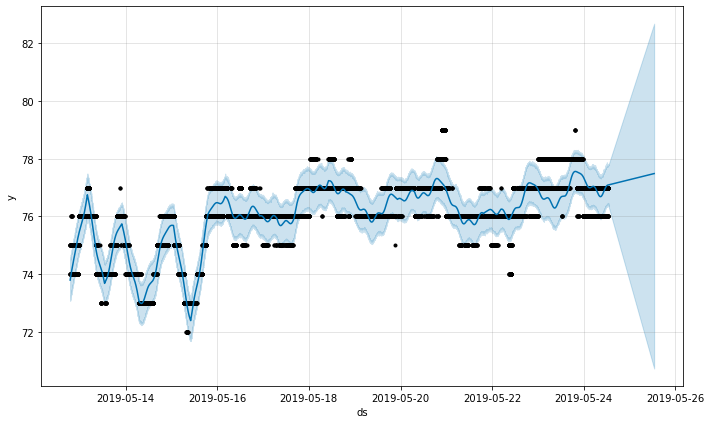

In [15]:
# Indoor plot with forecasting
ind_plot = ind.plot(ind_forecast)

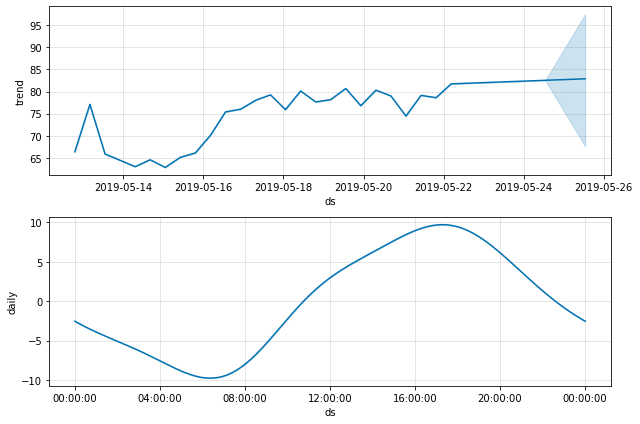

In [16]:
# Print outdoor trend and daily component
od_fig1 = od.plot_components(od_forecast)

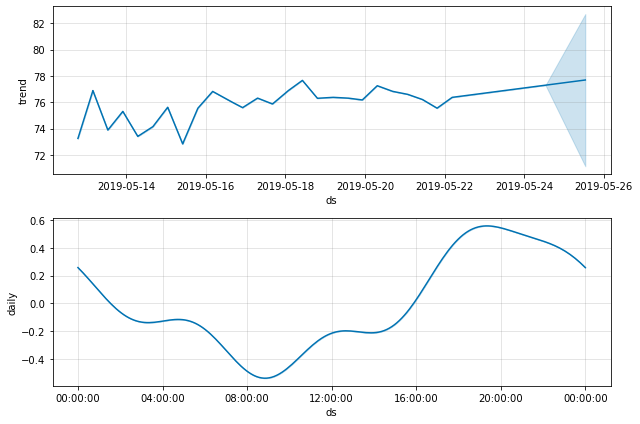

In [17]:
# Print indoor trend and daily component
ind_fig1 = ind.plot_components(ind_forecast)

In [18]:
# Print outdoor 
py.init_notebook_mode()
od_fig = plot_plotly(od, od_forecast)  # This returns a plotly Figure
py.iplot(od_fig)

In [19]:
# Print indoor plotly figure
ind_fig = plot_plotly(ind, ind_forecast)  # This returns a plotly Figure
py.iplot(ind_fig)

In [20]:
# Producing full plot for outdoor data
py.iplot([
    go.Scatter(x=outdoor['ds'], y=outdoor['y'], name='y'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['yhat'], name='yhat'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['yhat_upper'], fill='tonexty', mode='none', name='upper'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['yhat_lower'], fill='tonexty', mode='none', name='lower'),
    go.Scatter(x=od_forecast['ds'], y=od_forecast['trend'], name='Trend')
])

In [22]:
# Producing full plot for indoor data
py.iplot([
    go.Scatter(x=indoor['ds'], y=indoor['y'], name='y'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['yhat'], name='yhat'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['yhat_upper'], fill='tonexty', mode='none', name='upper'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['yhat_lower'], fill='tonexty', mode='none', name='lower'),
    go.Scatter(x=ind_forecast['ds'], y=ind_forecast['trend'], name='Trend')
])